# init

In [27]:
import numpy as np
import tensorflow_datasets as tfds
from PIL import Image
from IPython import display

DATASETS = [
    'fractal20220817_data',
    'kuka',
    'bridge',
    'taco_play',
    'jaco_play',
    'berkeley_cable_routing',
    'roboturk',
    'nyu_door_opening_surprising_effectiveness',
    'viola',
    'berkeley_autolab_ur5',
    'toto',
    'language_table',
    'columbia_cairlab_pusht_real',
    'stanford_kuka_multimodal_dataset_converted_externally_to_rlds',
    'nyu_rot_dataset_converted_externally_to_rlds',
    'stanford_hydra_dataset_converted_externally_to_rlds',
    'austin_buds_dataset_converted_externally_to_rlds',
    'nyu_franka_play_dataset_converted_externally_to_rlds',
    'maniskill_dataset_converted_externally_to_rlds',
    'cmu_franka_exploration_dataset_converted_externally_to_rlds',
    'ucsd_kitchen_dataset_converted_externally_to_rlds',
    'ucsd_pick_and_place_dataset_converted_externally_to_rlds',
    'austin_sailor_dataset_converted_externally_to_rlds',
    'austin_sirius_dataset_converted_externally_to_rlds',
    'bc_z',
    'usc_cloth_sim_converted_externally_to_rlds',
    'utokyo_pr2_opening_fridge_converted_externally_to_rlds',
    'utokyo_pr2_tabletop_manipulation_converted_externally_to_rlds',
    'utokyo_saytap_converted_externally_to_rlds',
    'utokyo_xarm_pick_and_place_converted_externally_to_rlds',
    'utokyo_xarm_bimanual_converted_externally_to_rlds',
    'robo_net',
    'berkeley_mvp_converted_externally_to_rlds',
    'berkeley_rpt_converted_externally_to_rlds',
    'kaist_nonprehensile_converted_externally_to_rlds',
    'stanford_mask_vit_converted_externally_to_rlds',
    'tokyo_u_lsmo_converted_externally_to_rlds',
    'dlr_sara_pour_converted_externally_to_rlds',
    'dlr_sara_grid_clamp_converted_externally_to_rlds',
    'dlr_edan_shared_control_converted_externally_to_rlds',
    'asu_table_top_converted_externally_to_rlds',
    'stanford_robocook_converted_externally_to_rlds',
    'eth_agent_affordances',
    'imperialcollege_sawyer_wrist_cam',
    'iamlab_cmu_pickup_insert_converted_externally_to_rlds',
    'uiuc_d3field',
    'utaustin_mutex',
    'berkeley_fanuc_manipulation',
    'cmu_play_fusion',
    'cmu_stretch',
    'berkeley_gnm_recon',
    'berkeley_gnm_cory_hall',
    'berkeley_gnm_sac_son'
]


def dataset2path(dataset_name):
  if dataset_name == 'robo_net':
    version = '1.0.0'
  elif dataset_name == 'language_table':
    version = '0.0.1'
  else:
    version = '0.1.0'
  return f'gs://gresearch/robotics/{dataset_name}/{version}'


def as_gif(images, path='temp.gif'):
  # Render the images as the gif:
  images[0].save(path, save_all=True, append_images=images[1:], duration=1000, loop=0)
  gif_bytes = open(path,'rb').read()
  return gif_bytes

In [3]:
# choose the dataset path in the dropdown on the right and rerun this cell
# to see multiple samples

dataset = 'fractal20220817_data' # @param ['fractal20220817_data', 'kuka', 'bridge', 'taco_play', 'jaco_play', 'berkeley_cable_routing', 'roboturk', 'nyu_door_opening_surprising_effectiveness', 'viola', 'berkeley_autolab_ur5', 'toto', 'language_table', 'columbia_cairlab_pusht_real', 'stanford_kuka_multimodal_dataset_converted_externally_to_rlds', 'nyu_rot_dataset_converted_externally_to_rlds', 'stanford_hydra_dataset_converted_externally_to_rlds', 'austin_buds_dataset_converted_externally_to_rlds', 'nyu_franka_play_dataset_converted_externally_to_rlds', 'maniskill_dataset_converted_externally_to_rlds', 'furniture_bench_dataset_converted_externally_to_rlds', 'cmu_franka_exploration_dataset_converted_externally_to_rlds', 'ucsd_kitchen_dataset_converted_externally_to_rlds', 'ucsd_pick_and_place_dataset_converted_externally_to_rlds', 'austin_sailor_dataset_converted_externally_to_rlds', 'austin_sirius_dataset_converted_externally_to_rlds', 'bc_z', 'usc_cloth_sim_converted_externally_to_rlds', 'utokyo_pr2_opening_fridge_converted_externally_to_rlds', 'utokyo_pr2_tabletop_manipulation_converted_externally_to_rlds', 'utokyo_saytap_converted_externally_to_rlds', 'utokyo_xarm_pick_and_place_converted_externally_to_rlds', 'utokyo_xarm_bimanual_converted_externally_to_rlds', 'robo_net', 'berkeley_mvp_converted_externally_to_rlds', 'berkeley_rpt_converted_externally_to_rlds', 'kaist_nonprehensile_converted_externally_to_rlds', 'stanford_mask_vit_converted_externally_to_rlds', 'tokyo_u_lsmo_converted_externally_to_rlds', 'dlr_sara_pour_converted_externally_to_rlds', 'dlr_sara_grid_clamp_converted_externally_to_rlds', 'dlr_edan_shared_control_converted_externally_to_rlds', 'asu_table_top_converted_externally_to_rlds', 'stanford_robocook_converted_externally_to_rlds', 'eth_agent_affordances', 'imperialcollege_sawyer_wrist_cam', 'iamlab_cmu_pickup_insert_converted_externally_to_rlds', 'uiuc_d3field', 'utaustin_mutex', 'berkeley_fanuc_manipulation', 'cmu_food_manipulation', 'cmu_play_fusion', 'cmu_stretch', 'berkeley_gnm_recon', 'berkeley_gnm_cory_hall', 'berkeley_gnm_sac_son']
display_key = 'image'

b = tfds.builder_from_directory(builder_dir=dataset2path(dataset))
b

In [4]:
ds = b.as_dataset(split='train[:1]')   # take only first 1 episodes
ds

<_PrefetchDataset element_spec={'aspects': {'already_success': TensorSpec(shape=(), dtype=tf.bool, name=None), 'feasible': TensorSpec(shape=(), dtype=tf.bool, name=None), 'has_aspects': TensorSpec(shape=(), dtype=tf.bool, name=None), 'success': TensorSpec(shape=(), dtype=tf.bool, name=None), 'undesirable': TensorSpec(shape=(), dtype=tf.bool, name=None)}, 'attributes': {'collection_mode': TensorSpec(shape=(), dtype=tf.int64, name=None), 'collection_mode_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'data_type': TensorSpec(shape=(), dtype=tf.int64, name=None), 'data_type_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'env': TensorSpec(shape=(), dtype=tf.int64, name=None), 'env_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'location': TensorSpec(shape=(), dtype=tf.int64, name=None), 'location_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'objects_family': TensorSpec(shape=(), dtype=tf.int64, name=None), 'objects_family_name': TensorSpec(shape=(),

In [90]:
ds = b.as_dataset(split='train[:10]').shuffle(10)   # take only first 10 episodes
ds

<_ShuffleDataset element_spec={'aspects': {'already_success': TensorSpec(shape=(), dtype=tf.bool, name=None), 'feasible': TensorSpec(shape=(), dtype=tf.bool, name=None), 'has_aspects': TensorSpec(shape=(), dtype=tf.bool, name=None), 'success': TensorSpec(shape=(), dtype=tf.bool, name=None), 'undesirable': TensorSpec(shape=(), dtype=tf.bool, name=None)}, 'attributes': {'collection_mode': TensorSpec(shape=(), dtype=tf.int64, name=None), 'collection_mode_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'data_type': TensorSpec(shape=(), dtype=tf.int64, name=None), 'data_type_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'env': TensorSpec(shape=(), dtype=tf.int64, name=None), 'env_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'location': TensorSpec(shape=(), dtype=tf.int64, name=None), 'location_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'objects_family': TensorSpec(shape=(), dtype=tf.int64, name=None), 'objects_family_name': TensorSpec(shape=(), 

In [91]:
ds = b.as_dataset(split='train[:10]').shuffle(10)   # take only first 10 episodes
episode = next(iter(ds))
episode

{'aspects': {'already_success': <tf.Tensor: shape=(), dtype=bool, numpy=False>,
  'feasible': <tf.Tensor: shape=(), dtype=bool, numpy=False>,
  'has_aspects': <tf.Tensor: shape=(), dtype=bool, numpy=False>,
  'success': <tf.Tensor: shape=(), dtype=bool, numpy=False>,
  'undesirable': <tf.Tensor: shape=(), dtype=bool, numpy=False>},
 'attributes': {'collection_mode': <tf.Tensor: shape=(), dtype=int64, numpy=0>,
  'collection_mode_name': <tf.Tensor: shape=(), dtype=string, numpy=b'UNSPECIFIED_COLLECTION_MODE'>,
  'data_type': <tf.Tensor: shape=(), dtype=int64, numpy=0>,
  'data_type_name': <tf.Tensor: shape=(), dtype=string, numpy=b'UNSPECIFIED_DATA_TYPE'>,
  'env': <tf.Tensor: shape=(), dtype=int64, numpy=0>,
  'env_name': <tf.Tensor: shape=(), dtype=string, numpy=b'UNSPECIFIED_ENV_TYPE'>,
  'location': <tf.Tensor: shape=(), dtype=int64, numpy=0>,
  'location_name': <tf.Tensor: shape=(), dtype=string, numpy=b'UNSPECIFIED_LOCATION'>,
  'objects_family': <tf.Tensor: shape=(), dtype=int64,

In [92]:
episode['steps']

<_VariantDataset element_spec={'action': {'base_displacement_vector': TensorSpec(shape=(2,), dtype=tf.float32, name=None), 'base_displacement_vertical_rotation': TensorSpec(shape=(1,), dtype=tf.float32, name=None), 'gripper_closedness_action': TensorSpec(shape=(1,), dtype=tf.float32, name=None), 'rotation_delta': TensorSpec(shape=(3,), dtype=tf.float32, name=None), 'terminate_episode': TensorSpec(shape=(3,), dtype=tf.int32, name=None), 'world_vector': TensorSpec(shape=(3,), dtype=tf.float32, name=None)}, 'is_first': TensorSpec(shape=(), dtype=tf.bool, name=None), 'is_last': TensorSpec(shape=(), dtype=tf.bool, name=None), 'is_terminal': TensorSpec(shape=(), dtype=tf.bool, name=None), 'observation': {'base_pose_tool_reached': TensorSpec(shape=(7,), dtype=tf.float32, name=None), 'gripper_closed': TensorSpec(shape=(1,), dtype=tf.float32, name=None), 'gripper_closedness_commanded': TensorSpec(shape=(1,), dtype=tf.float32, name=None), 'height_to_bottom': TensorSpec(shape=(1,), dtype=tf.float

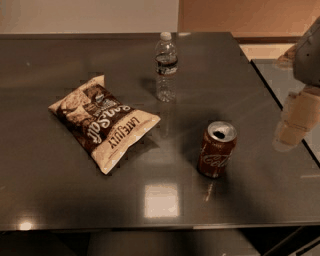

In [93]:
# print(episode.items()[]['natural_language_instruction'])

images = [step['observation'][display_key] for step in episode['steps']]
images = [Image.fromarray(image.numpy()) for image in images]
display.Image(as_gif(images))

In [33]:
len(episode['steps']) # 这个episode有22个step

22

In [94]:
for step in episode['steps']:
  # print(step)
  print(step['observation']['natural_language_instruction'])

tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move coke can near water bottle', shape=(), dtype=string)
tf.Tensor(b'move cok

In [85]:
next(iter(episode['steps']))

{'action': <tf.Tensor: shape=(2,), dtype=float32, numpy=array([-0.04211351, -0.007821  ], dtype=float32)>,
 'is_first': <tf.Tensor: shape=(), dtype=bool, numpy=True>,
 'is_last': <tf.Tensor: shape=(), dtype=bool, numpy=False>,
 'is_terminal': <tf.Tensor: shape=(), dtype=bool, numpy=False>,
 'observation': {'effector_target_translation': <tf.Tensor: shape=(2,), dtype=float32, numpy=array([ 0.42333966, -0.01039835], dtype=float32)>,
  'effector_translation': <tf.Tensor: shape=(2,), dtype=float32, numpy=array([ 0.42333964, -0.0079084 ], dtype=float32)>,
  'instruction': <tf.Tensor: shape=(512,), dtype=int32, numpy=
  array([109, 111, 118, 101,  32, 116, 104, 101,  32,  98, 108, 117, 101,
          32, 116, 114, 105,  97, 110, 103, 108, 101,  32,  98, 101, 108,
         111, 119,  32, 116, 104, 101,  32,  98, 108, 117, 101,  32,  99,
         117,  98, 101,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
           0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          

In [84]:
# other elements of the episode step --> this may vary for each dataset
for elem in next(iter(episode['steps'])).items():
  print(elem)
  print()

# 'natural_language_instruction'

('action', <tf.Tensor: shape=(2,), dtype=float32, numpy=array([-0.04211351, -0.007821  ], dtype=float32)>)

('is_first', <tf.Tensor: shape=(), dtype=bool, numpy=True>)

('is_last', <tf.Tensor: shape=(), dtype=bool, numpy=False>)

('is_terminal', <tf.Tensor: shape=(), dtype=bool, numpy=False>)

('observation', {'effector_target_translation': <tf.Tensor: shape=(2,), dtype=float32, numpy=array([ 0.42333966, -0.01039835], dtype=float32)>, 'effector_translation': <tf.Tensor: shape=(2,), dtype=float32, numpy=array([ 0.42333964, -0.0079084 ], dtype=float32)>, 'instruction': <tf.Tensor: shape=(512,), dtype=int32, numpy=
array([109, 111, 118, 101,  32, 116, 104, 101,  32,  98, 108, 117, 101,
        32, 116, 114, 105,  97, 110, 103, 108, 101,  32,  98, 101, 108,
       111, 119,  32, 116, 104, 101,  32,  98, 108, 117, 101,  32,  99,
       117,  98, 101,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0

In [45]:
%cd drive/MyDrive/RT-1/

drive	     step_11.jpg  step_15.jpg  step_19.jpg  step_2.jpg	step_6.jpg  temp.gif
sample_data  step_12.jpg  step_16.jpg  step_1.jpg   step_3.jpg	step_7.jpg
step_0.jpg   step_13.jpg  step_17.jpg  step_20.jpg  step_4.jpg	step_8.jpg
step_10.jpg  step_14.jpg  step_18.jpg  step_21.jpg  step_5.jpg	step_9.jpg


In [47]:
import cv2

images = [step['observation'][display_key] for step in episode['steps']]
images = [np.array(image.numpy()) for image in images]

idx = 0
# a = np.array(images[idx])
# type(a)
for image in images:
  cv2.cvtColor(image, cv2.COLOR_BGR2RGB, image)
  cv2.imwrite('drive/MyDrive/RT-1/step_{}.jpg'.format(idx), image)
  idx += 1

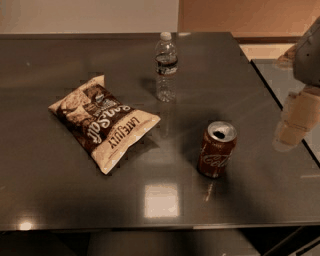

In [48]:
# gif generate
images = [step['observation'][display_key] for step in episode['steps']]
images = [Image.fromarray(image.numpy()) for image in images]
display.Image(as_gif(images))

## language-table-X

[language-table-colab](https://colab.research.google.com/github/google-research/language-table/blob/main/language_table/examples/language_table_tutorial.ipynb#scrollTo=NUtDMoCfiL13)

In [77]:
def decode_inst(inst):
  """Utility to decode encoded language instruction"""
  return bytes(inst[np.where(inst != 0)].tolist()).decode("utf-8")

In [79]:
dataset_language_table = 'language_table' # @param ['fractal20220817_data', 'kuka', 'bridge', 'taco_play', 'jaco_play', 'berkeley_cable_routing', 'roboturk', 'nyu_door_opening_surprising_effectiveness', 'viola', 'berkeley_autolab_ur5', 'toto', 'language_table', 'columbia_cairlab_pusht_real', 'stanford_kuka_multimodal_dataset_converted_externally_to_rlds', 'nyu_rot_dataset_converted_externally_to_rlds', 'stanford_hydra_dataset_converted_externally_to_rlds', 'austin_buds_dataset_converted_externally_to_rlds', 'nyu_franka_play_dataset_converted_externally_to_rlds', 'maniskill_dataset_converted_externally_to_rlds', 'furniture_bench_dataset_converted_externally_to_rlds', 'cmu_franka_exploration_dataset_converted_externally_to_rlds', 'ucsd_kitchen_dataset_converted_externally_to_rlds', 'ucsd_pick_and_place_dataset_converted_externally_to_rlds', 'austin_sailor_dataset_converted_externally_to_rlds', 'austin_sirius_dataset_converted_externally_to_rlds', 'bc_z', 'usc_cloth_sim_converted_externally_to_rlds', 'utokyo_pr2_opening_fridge_converted_externally_to_rlds', 'utokyo_pr2_tabletop_manipulation_converted_externally_to_rlds', 'utokyo_saytap_converted_externally_to_rlds', 'utokyo_xarm_pick_and_place_converted_externally_to_rlds', 'utokyo_xarm_bimanual_converted_externally_to_rlds', 'robo_net', 'berkeley_mvp_converted_externally_to_rlds', 'berkeley_rpt_converted_externally_to_rlds', 'kaist_nonprehensile_converted_externally_to_rlds', 'stanford_mask_vit_converted_externally_to_rlds', 'tokyo_u_lsmo_converted_externally_to_rlds', 'dlr_sara_pour_converted_externally_to_rlds', 'dlr_sara_grid_clamp_converted_externally_to_rlds', 'dlr_edan_shared_control_converted_externally_to_rlds', 'asu_table_top_converted_externally_to_rlds', 'stanford_robocook_converted_externally_to_rlds', 'eth_agent_affordances', 'imperialcollege_sawyer_wrist_cam', 'iamlab_cmu_pickup_insert_converted_externally_to_rlds', 'uiuc_d3field', 'utaustin_mutex', 'berkeley_fanuc_manipulation', 'cmu_food_manipulation', 'cmu_play_fusion', 'cmu_stretch', 'berkeley_gnm_recon', 'berkeley_gnm_cory_hall', 'berkeley_gnm_sac_son']
display_key = 'rgb'

b_language_table = tfds.builder_from_directory(builder_dir=dataset2path(dataset_language_table))


ds_language_table = b_language_table.as_dataset(split='train[:20]').shuffle(20)   # take only first 10 episodes
episode = next(iter(ds_language_table))

print('This episode have {} sub-steps.'.format(len(episode['steps']))) # 这个episode有22个step

for step in episode['steps']:
  # print(step)
  print('Instruction:',decode_inst(step['observation']['instruction'].numpy()))

This episode have 12 sub-steps.
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube
Instruction: move the blue triangle below the blue cube


In [80]:
# show info of a episode

# other elements of the episode step --> this may vary for each dataset
for elem in next(iter(episode['steps'])).items():
  print(elem)
  print()

# 'natural_language_instruction'

('action', <tf.Tensor: shape=(2,), dtype=float32, numpy=array([-0.04211351, -0.007821  ], dtype=float32)>)

('is_first', <tf.Tensor: shape=(), dtype=bool, numpy=True>)

('is_last', <tf.Tensor: shape=(), dtype=bool, numpy=False>)

('is_terminal', <tf.Tensor: shape=(), dtype=bool, numpy=False>)

('observation', {'effector_target_translation': <tf.Tensor: shape=(2,), dtype=float32, numpy=array([ 0.42333966, -0.01039835], dtype=float32)>, 'effector_translation': <tf.Tensor: shape=(2,), dtype=float32, numpy=array([ 0.42333964, -0.0079084 ], dtype=float32)>, 'instruction': <tf.Tensor: shape=(512,), dtype=int32, numpy=
array([109, 111, 118, 101,  32, 116, 104, 101,  32,  98, 108, 117, 101,
        32, 116, 114, 105,  97, 110, 103, 108, 101,  32,  98, 101, 108,
       111, 119,  32, 116, 104, 101,  32,  98, 108, 117, 101,  32,  99,
       117,  98, 101,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0

In [81]:
import cv2

images = [step['observation'][display_key] for step in episode['steps']]
images = [np.array(image.numpy()) for image in images]

idx = 0
# a = np.array(images[idx])
# type(a)
for image in images:
  cv2.cvtColor(image, cv2.COLOR_BGR2RGB, image)
  cv2.imwrite('drive/MyDrive/RT-1/step_{}.jpg'.format(idx), image)
  idx += 1

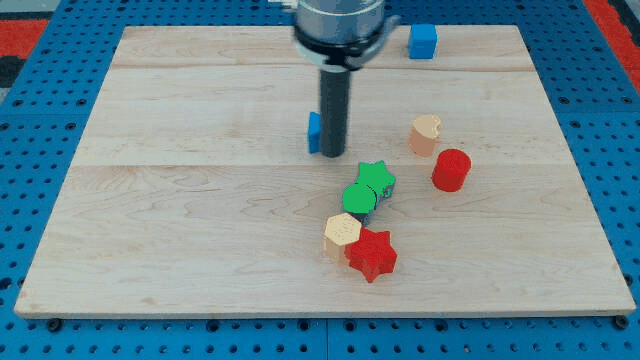

In [83]:
images = [step['observation'][display_key] for step in episode['steps']]

images = [Image.fromarray(image.numpy()) for image in images]
display.Image(as_gif(images))

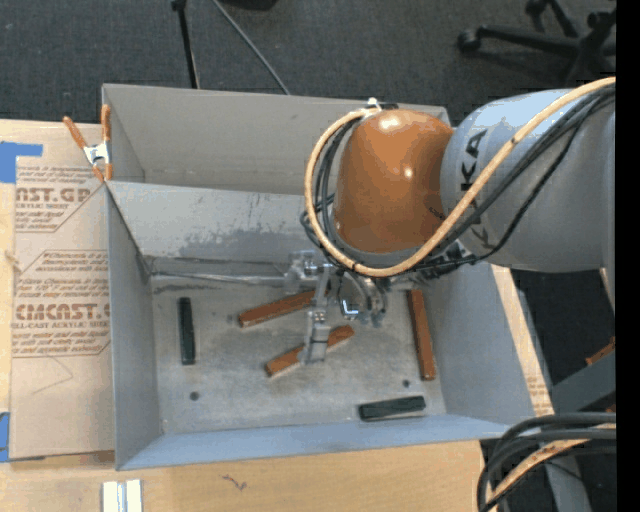

In [ ]:
dataset = 'kuka' # @param ['fractal20220817_data', 'kuka', 'bridge', 'taco_play', 'jaco_play', 'berkeley_cable_routing', 'roboturk', 'nyu_door_opening_surprising_effectiveness', 'viola', 'berkeley_autolab_ur5', 'toto', 'language_table', 'columbia_cairlab_pusht_real', 'stanford_kuka_multimodal_dataset_converted_externally_to_rlds', 'nyu_rot_dataset_converted_externally_to_rlds', 'stanford_hydra_dataset_converted_externally_to_rlds', 'austin_buds_dataset_converted_externally_to_rlds', 'nyu_franka_play_dataset_converted_externally_to_rlds', 'maniskill_dataset_converted_externally_to_rlds', 'furniture_bench_dataset_converted_externally_to_rlds', 'cmu_franka_exploration_dataset_converted_externally_to_rlds', 'ucsd_kitchen_dataset_converted_externally_to_rlds', 'ucsd_pick_and_place_dataset_converted_externally_to_rlds', 'austin_sailor_dataset_converted_externally_to_rlds', 'austin_sirius_dataset_converted_externally_to_rlds', 'bc_z', 'usc_cloth_sim_converted_externally_to_rlds', 'utokyo_pr2_opening_fridge_converted_externally_to_rlds', 'utokyo_pr2_tabletop_manipulation_converted_externally_to_rlds', 'utokyo_saytap_converted_externally_to_rlds', 'utokyo_xarm_pick_and_place_converted_externally_to_rlds', 'utokyo_xarm_bimanual_converted_externally_to_rlds', 'robo_net', 'berkeley_mvp_converted_externally_to_rlds', 'berkeley_rpt_converted_externally_to_rlds', 'kaist_nonprehensile_converted_externally_to_rlds', 'stanford_mask_vit_converted_externally_to_rlds', 'tokyo_u_lsmo_converted_externally_to_rlds', 'dlr_sara_pour_converted_externally_to_rlds', 'dlr_sara_grid_clamp_converted_externally_to_rlds', 'dlr_edan_shared_control_converted_externally_to_rlds', 'asu_table_top_converted_externally_to_rlds', 'stanford_robocook_converted_externally_to_rlds', 'eth_agent_affordances', 'imperialcollege_sawyer_wrist_cam', 'iamlab_cmu_pickup_insert_converted_externally_to_rlds', 'uiuc_d3field', 'utaustin_mutex', 'berkeley_fanuc_manipulation', 'cmu_food_manipulation', 'cmu_play_fusion', 'cmu_stretch', 'berkeley_gnm_recon', 'berkeley_gnm_cory_hall', 'berkeley_gnm_sac_son']
display_key = 'image'

b = tfds.builder_from_directory(builder_dir=dataset2path(dataset))


ds = b.as_dataset(split='train[:10]').shuffle(10)   # take only first 10 episodes
episode = next(iter(ds))
images = [step['observation'][display_key] for step in episode['steps']]
images = [Image.fromarray(image.numpy()) for image in images]
display.Image(as_gif(images))

In [ ]:
# other elements of the episode step --> this may vary for each dataset
for elem in next(iter(episode['steps'])).items():
  print(elem)
  print()

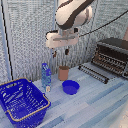

In [ ]:
dataset = 'kuka' # @param ['fractal20220817_data', 'kuka', 'bridge', 'taco_play', 'jaco_play', 'berkeley_cable_routing', 'roboturk', 'nyu_door_opening_surprising_effectiveness', 'viola', 'berkeley_autolab_ur5', 'toto', 'language_table', 'columbia_cairlab_pusht_real', 'stanford_kuka_multimodal_dataset_converted_externally_to_rlds', 'nyu_rot_dataset_converted_externally_to_rlds', 'stanford_hydra_dataset_converted_externally_to_rlds', 'austin_buds_dataset_converted_externally_to_rlds', 'nyu_franka_play_dataset_converted_externally_to_rlds', 'maniskill_dataset_converted_externally_to_rlds', 'furniture_bench_dataset_converted_externally_to_rlds', 'cmu_franka_exploration_dataset_converted_externally_to_rlds', 'ucsd_kitchen_dataset_converted_externally_to_rlds', 'ucsd_pick_and_place_dataset_converted_externally_to_rlds', 'austin_sailor_dataset_converted_externally_to_rlds', 'austin_sirius_dataset_converted_externally_to_rlds', 'bc_z', 'usc_cloth_sim_converted_externally_to_rlds', 'utokyo_pr2_opening_fridge_converted_externally_to_rlds', 'utokyo_pr2_tabletop_manipulation_converted_externally_to_rlds', 'utokyo_saytap_converted_externally_to_rlds', 'utokyo_xarm_pick_and_place_converted_externally_to_rlds', 'utokyo_xarm_bimanual_converted_externally_to_rlds', 'robo_net', 'berkeley_mvp_converted_externally_to_rlds', 'berkeley_rpt_converted_externally_to_rlds', 'kaist_nonprehensile_converted_externally_to_rlds', 'stanford_mask_vit_converted_externally_to_rlds', 'tokyo_u_lsmo_converted_externally_to_rlds', 'dlr_sara_pour_converted_externally_to_rlds', 'dlr_sara_grid_clamp_converted_externally_to_rlds', 'dlr_edan_shared_control_converted_externally_to_rlds', 'asu_table_top_converted_externally_to_rlds', 'stanford_robocook_converted_externally_to_rlds', 'eth_agent_affordances', 'imperialcollege_sawyer_wrist_cam', 'iamlab_cmu_pickup_insert_converted_externally_to_rlds', 'uiuc_d3field', 'utaustin_mutex', 'berkeley_fanuc_manipulation', 'cmu_food_manipulation', 'cmu_play_fusion', 'cmu_stretch', 'berkeley_gnm_recon', 'berkeley_gnm_cory_hall', 'berkeley_gnm_sac_son']
display_key = 'image'

b = tfds.builder_from_directory(builder_dir=dataset2path(dataset))


ds = b.as_dataset(split='train[:10]').shuffle(10)   # take only first 10 episodes
episode = next(iter(ds))
images = [step['observation'][display_key] for step in episode['steps']]
images = [Image.fromarray(image.numpy()) for image in images]
display.Image(as_gif(images))

In [ ]:
# other elements of the episode step --> this may vary for each dataset
for elem in next(iter(episode['steps'])).items():
  print(elem)
  print()

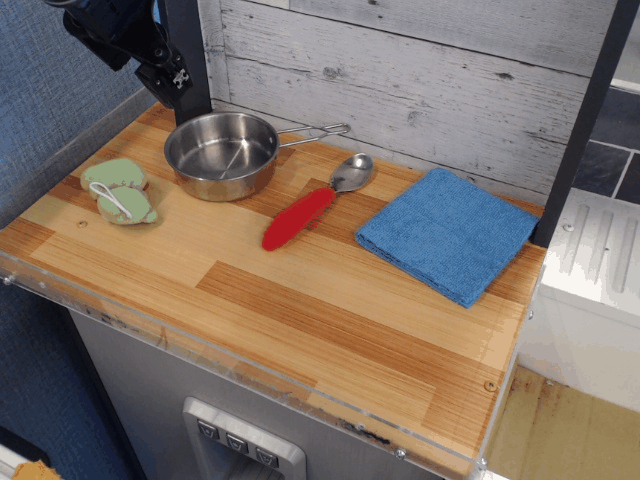

In [ ]:
dataset_bridge = 'bridge' # @param ['fractal20220817_data', 'kuka', 'bridge', 'taco_play', 'jaco_play', 'berkeley_cable_routing', 'roboturk', 'nyu_door_opening_surprising_effectiveness', 'viola', 'berkeley_autolab_ur5', 'toto', 'language_table', 'columbia_cairlab_pusht_real', 'stanford_kuka_multimodal_dataset_converted_externally_to_rlds', 'nyu_rot_dataset_converted_externally_to_rlds', 'stanford_hydra_dataset_converted_externally_to_rlds', 'austin_buds_dataset_converted_externally_to_rlds', 'nyu_franka_play_dataset_converted_externally_to_rlds', 'maniskill_dataset_converted_externally_to_rlds', 'furniture_bench_dataset_converted_externally_to_rlds', 'cmu_franka_exploration_dataset_converted_externally_to_rlds', 'ucsd_kitchen_dataset_converted_externally_to_rlds', 'ucsd_pick_and_place_dataset_converted_externally_to_rlds', 'austin_sailor_dataset_converted_externally_to_rlds', 'austin_sirius_dataset_converted_externally_to_rlds', 'bc_z', 'usc_cloth_sim_converted_externally_to_rlds', 'utokyo_pr2_opening_fridge_converted_externally_to_rlds', 'utokyo_pr2_tabletop_manipulation_converted_externally_to_rlds', 'utokyo_saytap_converted_externally_to_rlds', 'utokyo_xarm_pick_and_place_converted_externally_to_rlds', 'utokyo_xarm_bimanual_converted_externally_to_rlds', 'robo_net', 'berkeley_mvp_converted_externally_to_rlds', 'berkeley_rpt_converted_externally_to_rlds', 'kaist_nonprehensile_converted_externally_to_rlds', 'stanford_mask_vit_converted_externally_to_rlds', 'tokyo_u_lsmo_converted_externally_to_rlds', 'dlr_sara_pour_converted_externally_to_rlds', 'dlr_sara_grid_clamp_converted_externally_to_rlds', 'dlr_edan_shared_control_converted_externally_to_rlds', 'asu_table_top_converted_externally_to_rlds', 'stanford_robocook_converted_externally_to_rlds', 'eth_agent_affordances', 'imperialcollege_sawyer_wrist_cam', 'iamlab_cmu_pickup_insert_converted_externally_to_rlds', 'uiuc_d3field', 'utaustin_mutex', 'berkeley_fanuc_manipulation', 'cmu_food_manipulation', 'cmu_play_fusion', 'cmu_stretch', 'berkeley_gnm_recon', 'berkeley_gnm_cory_hall', 'berkeley_gnm_sac_son']
bridge_display_key = 'image'

b_bridge = tfds.builder_from_directory(builder_dir=dataset2path(dataset_bridge))

ds_language_table = b_bridge.as_dataset(split='train[:10]').shuffle(10)   # take only first 10 episodes
episode = next(iter(ds_language_table))
images = [step['observation'][bridge_display_key] for step in episode['steps']]
images = [Image.fromarray(image.numpy()) for image in images]
display.Image(as_gif(images))


In [ ]:
!pip install tfds-nightly   # to get most up-to-date registered datasets

In [ ]:
import tensorflow_datasets as tfds
import tqdm

# optionally replace the DATASET_NAMES below with the list of filtered datasets from the google sheet
DATASET_NAMES = ['fractal_20220817_data', 'kuka', 'bridge', 'taco_play', 'jaco_play', 'berkeley_cable_routing', 'roboturk', 'nyu_door_opening_surprising_effectiveness', 'viola', 'berkeley_autolab_ur5', 'toto', 'language_table', 'columbia_cairlab_pusht_real', 'stanford_kuka_multimodal_dataset_converted_externally_to_rlds', 'nyu_rot_dataset_converted_externally_to_rlds', 'stanford_hydra_dataset_converted_externally_to_rlds', 'austin_buds_dataset_converted_externally_to_rlds', 'nyu_franka_play_dataset_converted_externally_to_rlds', 'maniskill_dataset_converted_externally_to_rlds', 'furniture_bench_dataset_converted_externally_to_rlds', 'cmu_franka_exploration_dataset_converted_externally_to_rlds', 'ucsd_kitchen_dataset_converted_externally_to_rlds', 'ucsd_pick_and_place_dataset_converted_externally_to_rlds', 'austin_sailor_dataset_converted_externally_to_rlds', 'austin_sirius_dataset_converted_externally_to_rlds', 'bc_z', 'usc_cloth_sim_converted_externally_to_rlds', 'utokyo_pr2_opening_fridge_converted_externally_to_rlds', 'utokyo_pr2_tabletop_manipulation_converted_externally_to_rlds', 'utokyo_saytap_converted_externally_to_rlds', 'utokyo_xarm_pick_and_place_converted_externally_to_rlds', 'utokyo_xarm_bimanual_converted_externally_to_rlds', 'robo_net', 'berkeley_mvp_converted_externally_to_rlds', 'berkeley_rpt_converted_externally_to_rlds', 'kaist_nonprehensile_converted_externally_to_rlds', 'stanford_mask_vit_converted_externally_to_rlds', 'tokyo_u_lsmo_converted_externally_to_rlds', 'dlr_sara_pour_converted_externally_to_rlds', 'dlr_sara_grid_clamp_converted_externally_to_rlds', 'dlr_edan_shared_control_converted_externally_to_rlds', 'asu_table_top_converted_externally_to_rlds', 'stanford_robocook_converted_externally_to_rlds', 'eth_agent_affordances', 'imperialcollege_sawyer_wrist_cam', 'iamlab_cmu_pickup_insert_converted_externally_to_rlds', 'uiuc_d3field', 'utaustin_mutex', 'berkeley_fanuc_manipulation', 'cmu_food_manipulation', 'cmu_play_fusion', 'cmu_stretch', 'berkeley_gnm_recon', 'berkeley_gnm_cory_hall', 'berkeley_gnm_sac_son']
DOWNLOAD_DIR = '~/tensorflow_datasets'

print(f"Downloading {len(DATASET_NAMES)} datasets to {DOWNLOAD_DIR}.")
for dataset_name in tqdm.tqdm(DATASET_NAMES):
  _ = tfds.load(dataset_name, data_dir=DOWNLOAD_DIR)

In [ ]:
!pip install rlds[tensorflow]
import rlds

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.4/48.4 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 18.6 MB/s eta 0:00:00


In [ ]:
import rlds

In [ ]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


**X-Embodiment 训练使用的机器人数据(9个机械手数据)**


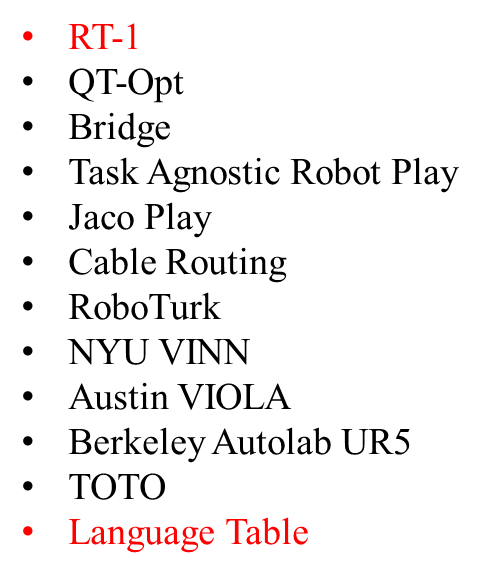

**analysis and show ['action']**

In [159]:
import tensorflow as tf
import tensorflow_datasets as tfds

# load raw dataset --> replace this with tfds.load(<dataset_name>) on your
# local machine!


RT_X_train_DATASETS = ['fractal20220817_data', 'bridge', 'roboturk', 'toto', 'language_table']  # RT-X training dataset

for dataset in RT_X_train_DATASETS:
  print()
  print('This dataset is:', dataset)
  b = tfds.builder_from_directory(builder_dir=dataset2path(dataset))
  ds = b.as_dataset(split='train[:2]')

  episode = next(iter(ds))
  steps = next(iter(episode['steps']))
  print(steps['action'])
  keys = [key for key in steps['observation'].keys()]
  print('The keys of observation:\n', keys)
  print()


This dataset is: fractal20220817_data
{'base_displacement_vector': <tf.Tensor: shape=(2,), dtype=float32, numpy=array([0., 0.], dtype=float32)>, 'base_displacement_vertical_rotation': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([0.], dtype=float32)>, 'gripper_closedness_action': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([0.], dtype=float32)>, 'rotation_delta': <tf.Tensor: shape=(3,), dtype=float32, numpy=array([-0.06926762, -0.04492378,  0.01337339], dtype=float32)>, 'terminate_episode': <tf.Tensor: shape=(3,), dtype=int32, numpy=array([0, 1, 0], dtype=int32)>, 'world_vector': <tf.Tensor: shape=(3,), dtype=float32, numpy=array([-0.01469174, -0.00486539, -0.01381669], dtype=float32)>}
The keys of observation:
 ['base_pose_tool_reached', 'gripper_closed', 'gripper_closedness_commanded', 'height_to_bottom', 'image', 'natural_language_embedding', 'natural_language_instruction', 'orientation_box', 'orientation_start', 'robot_orientation_positions_box', 'rotation_delta_to_go

# Data Loader Example

下面展示了如何将数据集加载到训练批次中的一个简单示例，其中批次中的每个样本只包含一个步骤。

In [162]:
import tensorflow as tf
import tensorflow_datasets as tfds

# load raw dataset --> replace this with tfds.load(<dataset_name>) on your
# local machine!


for dataset in DATASETS[:5]:
  print()
  print('This dataset is:', dataset)
  b = tfds.builder_from_directory(builder_dir=dataset2path(dataset))
  ds = b.as_dataset(split='train[:2]')

  episode = next(iter(ds))
  steps = next(iter(episode['steps']))
  print(steps['action'])
  keys = [key for key in steps['observation'].keys()]
  print('The keys of observation:\n', keys)
  print()


This dataset is: fractal20220817_data
{'base_displacement_vector': <tf.Tensor: shape=(2,), dtype=float32, numpy=array([0., 0.], dtype=float32)>, 'base_displacement_vertical_rotation': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([0.], dtype=float32)>, 'gripper_closedness_action': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([0.], dtype=float32)>, 'rotation_delta': <tf.Tensor: shape=(3,), dtype=float32, numpy=array([-0.06926762, -0.04492378,  0.01337339], dtype=float32)>, 'terminate_episode': <tf.Tensor: shape=(3,), dtype=int32, numpy=array([0, 1, 0], dtype=int32)>, 'world_vector': <tf.Tensor: shape=(3,), dtype=float32, numpy=array([-0.01469174, -0.00486539, -0.01381669], dtype=float32)>}
The keys of observation:
 ['base_pose_tool_reached', 'gripper_closed', 'gripper_closedness_commanded', 'height_to_bottom', 'image', 'natural_language_embedding', 'natural_language_instruction', 'orientation_box', 'orientation_start', 'robot_orientation_positions_box', 'rotation_delta_to_go

## kuka dataset ex

In [167]:
import tensorflow as tf
import tensorflow_datasets as tfds

# load raw dataset --> replace this with tfds.load(<dataset_name>) on your
# local machine!

dataset = 'kuka'
b = tfds.builder_from_directory(builder_dir=dataset2path(dataset))
ds_kuka = b.as_dataset(split='train[:10]')

def episode2steps(episode):
  return episode['steps']

def step_map_fn(step):
  return {
      'observation': {
          'image': tf.image.resize(step['observation']['image'], (128, 128)),
      },
      'action': tf.concat([
          step['action']['world_vector'],
          step['action']['rotation_delta'],
          step['action']['gripper_closedness_action'],
      ], axis=-1)
  }

# convert RLDS episode dataset to individual steps & reformat
ds_kuka = ds_kuka.map(
    episode2steps, num_parallel_calls=tf.data.AUTOTUNE).flat_map(lambda x: x)

ds_kuka = ds_kuka.map(step_map_fn, num_parallel_calls=tf.data.AUTOTUNE)

# shuffle, repeat, pre-fetch, batch
ds_kuka = ds_kuka.cache()         # optionally keep full dataset in memory
ds_kuka = ds_kuka.shuffle(100)    # set shuffle buffer size
ds_kuka = ds_kuka.repeat()        # ensure that data never runs out

In [104]:
next(iter(ds))

{'observation': {'image': <tf.Tensor: shape=(128, 128, 3), dtype=float32, numpy=
  array([[[ 64. ,  75. ,  75.5],
          [ 68. ,  78. ,  82.5],
          [ 68. ,  78.5,  80.5],
          ...,
          [  0. ,   0. ,   0. ],
          [  0. ,   0. ,   0. ],
          [  0. ,   0. ,   0. ]],
  
         [[ 73.5,  80.5,  86.5],
          [ 75. ,  82. ,  88. ],
          [ 71. ,  79. ,  81.5],
          ...,
          [  0. ,   0. ,   0. ],
          [  0. ,   0. ,   0. ],
          [  0. ,   0. ,   0. ]],
  
         [[ 68. ,  78. ,  84.5],
          [ 63.5,  73.5,  78. ],
          [ 65. ,  75.5,  77.5],
          ...,
          [  0. ,   0. ,   0. ],
          [  0. ,   0. ,   0. ],
          [  0. ,   0. ,   0. ]],
  
         ...,
  
         [[219. , 197.5, 163. ],
          [218.5, 197.5, 160.5],
          [225. , 205. , 171. ],
          ...,
          [  0. ,   0. ,   0. ],
          [  0. ,   0. ,   0. ],
          [  0. ,   0. ,   0. ]],
  
         [[224.5, 201.5, 167.5],
 

In [106]:
import cv2
cv2.cvtColor(image, cv2.COLOR_BGR2RGB, image)
cv2.imwrite('drive/MyDrive/RT-1/kuka_first_step.jpg', next(iter(ds))['observation']['image'].numpy())

True

In [112]:
images = [step['observation']['image'].numpy() for step in ds.take(10)]
instruction = [step['action'].numpy() for step in ds.take(10)]
# print(len(images))
print(instruction[0])
# cv2.imwrite('drive/MyDrive/RT-1/step_{}.jpg'.format(idx), image)

10
[ 0.00879149 -0.05706418  0.00475045  0.          0.         -0.00901032
  0.        ]


# Interleave Multiple Datasets

## utaustin_mutex dataset

In [168]:
# Load second dataset --> replace this with tfds.load(<dataset_name>) on your
# local machine!
dataset = 'utaustin_mutex'
b = tfds.builder_from_directory(builder_dir=dataset2path(dataset))
ds_um = b.as_dataset(split='train[:10]')

def step_map_fn_mutex(step):
  # reformat to align specs of both datasets
  return {
      'observation': {
          'image': tf.image.resize(step['observation']['image'], (128, 128)),
      },
      'action': step['action'],
  }

ds_um = ds_um.map(
    episode2steps, num_parallel_calls=tf.data.AUTOTUNE).flat_map(lambda x: x)
ds_um = ds_um.map(step_map_fn_mutex, num_parallel_calls=tf.data.AUTOTUNE)

# shuffle, repeat, pre-fetch, batch
ds_um = ds_um.cache()         # optionally keep full dataset in memory
ds_um = ds_um.shuffle(100)    # set shuffle buffer size
ds_um = ds_um.repeat()        # ensure that data never runs out

## RT-1 dataset ex

In [166]:
import tensorflow as tf
import tensorflow_datasets as tfds

# load raw dataset --> replace this with tfds.load(<dataset_name>) on your
# local machine!

dataset = 'fractal20220817_data' # @param ['fractal20220817_data', 'kuka', 'bridge', 'taco_play', 'jaco_play', 'berkeley_cable_routing', 'roboturk', 'nyu_door_opening_surprising_effectiveness', 'viola', 'berkeley_autolab_ur5', 'toto', 'language_table', 'columbia_cairlab_pusht_real', 'stanford_kuka_multimodal_dataset_converted_externally_to_rlds', 'nyu_rot_dataset_converted_externally_to_rlds', 'stanford_hydra_dataset_converted_externally_to_rlds', 'austin_buds_dataset_converted_externally_to_rlds', 'nyu_franka_play_dataset_converted_externally_to_rlds', 'maniskill_dataset_converted_externally_to_rlds', 'furniture_bench_dataset_converted_externally_to_rlds', 'cmu_franka_exploration_dataset_converted_externally_to_rlds', 'ucsd_kitchen_dataset_converted_externally_to_rlds', 'ucsd_pick_and_place_dataset_converted_externally_to_rlds', 'austin_sailor_dataset_converted_externally_to_rlds', 'austin_sirius_dataset_converted_externally_to_rlds', 'bc_z', 'usc_cloth_sim_converted_externally_to_rlds', 'utokyo_pr2_opening_fridge_converted_externally_to_rlds', 'utokyo_pr2_tabletop_manipulation_converted_externally_to_rlds', 'utokyo_saytap_converted_externally_to_rlds', 'utokyo_xarm_pick_and_place_converted_externally_to_rlds', 'utokyo_xarm_bimanual_converted_externally_to_rlds', 'robo_net', 'berkeley_mvp_converted_externally_to_rlds', 'berkeley_rpt_converted_externally_to_rlds', 'kaist_nonprehensile_converted_externally_to_rlds', 'stanford_mask_vit_converted_externally_to_rlds', 'tokyo_u_lsmo_converted_externally_to_rlds', 'dlr_sara_pour_converted_externally_to_rlds', 'dlr_sara_grid_clamp_converted_externally_to_rlds', 'dlr_edan_shared_control_converted_externally_to_rlds', 'asu_table_top_converted_externally_to_rlds', 'stanford_robocook_converted_externally_to_rlds', 'eth_agent_affordances', 'imperialcollege_sawyer_wrist_cam', 'iamlab_cmu_pickup_insert_converted_externally_to_rlds', 'uiuc_d3field', 'utaustin_mutex', 'berkeley_fanuc_manipulation', 'cmu_food_manipulation', 'cmu_play_fusion', 'cmu_stretch', 'berkeley_gnm_recon', 'berkeley_gnm_cory_hall', 'berkeley_gnm_sac_son']

b = tfds.builder_from_directory(builder_dir=dataset2path(dataset))
ds_RT1 = b.as_dataset(split='train[:10]')

def episode2steps(episode):
  return episode['steps']

def step_map_fn(step):
  return {
      'observation': {
          'image': tf.image.resize(step['observation']['image'], (128, 128)),
      },
      'action': tf.concat([
          step['action']['world_vector'],
          step['action']['rotation_delta'],
          step['action']['gripper_closedness_action'],
      ], axis=-1)
  }

# convert RLDS episode dataset to individual steps & reformat
ds_RT1 = ds.map(
    episode2steps, num_parallel_calls=tf.data.AUTOTUNE).flat_map(lambda x: x)

ds_RT1 = ds_RT1.map(step_map_fn, num_parallel_calls=tf.data.AUTOTUNE)

# shuffle, repeat, pre-fetch, batch
ds_RT1 = ds_RT1.cache()         # optionally keep full dataset in memory
ds_RT1 = ds_RT1.shuffle(100)    # set shuffle buffer size
ds_RT1 = ds_RT1.repeat()        # ensure that data never runs out

In [169]:
# interleave datasets w/ equal sampling weight
ds_combined = tf.data.Dataset.sample_from_datasets([ds_kuka, ds_um, ds_RT1], [0.5, 0.5, 0.5])

In [170]:
next(iter(ds_combined))

{'observation': {'image': <tf.Tensor: shape=(128, 128, 3), dtype=float32, numpy=
  array([[[165., 179., 191.],
          [175., 183., 196.],
          [198., 202., 203.],
          ...,
          [146., 160., 158.],
          [163., 169., 168.],
          [153., 161., 160.]],
  
         [[167., 178., 192.],
          [173., 181., 194.],
          [203., 206., 204.],
          ...,
          [140., 154., 150.],
          [159., 168., 165.],
          [150., 161., 158.]],
  
         [[165., 175., 185.],
          [170., 177., 186.],
          [194., 197., 202.],
          ...,
          [132., 145., 143.],
          [137., 146., 143.],
          [142., 156., 152.]],
  
         ...,
  
         [[ 56.,  37.,  34.],
          [ 57.,  38.,  35.],
          [ 57.,  41.,  35.],
          ...,
          [225., 211., 193.],
          [224., 210., 192.],
          [223., 209., 191.]],
  
         [[ 56.,  37.,  34.],
          [ 57.,  38.,  35.],
          [ 59.,  40.,  35.],
          ...,
 

In [96]:
import tqdm

for i, batch in tqdm.tqdm(
    enumerate(ds.prefetch(3).batch(4).as_numpy_iterator())):
  # here you would add your Jax / PyTorch training code
  if i == 10000: break

10000it [00:07, 1348.97it/s]


#Example Dataloader to produce trajectories

When training transformers, we usually use trajectories of fix-length as input into the transformers. This is to enable the transformer to condition on a fixed window of history when predicting actions.

Below we demonstrate how one can load the TFDS datasets, transform the episodes into fixed-length "trajectories" and mix multiple datasets by aligning their specs.


在训练Transformers时,我们通常使用固定长度的trajectories作为Transformers的输入。这是为了使Transformers在预测动作时能够以固定的历史窗口为条件。

下面我们展示了如何加载TFDS数据集, 将剧集转换为固定长度的"trajectories"，并通过调整其规格来混合多个数据集。

In [9]:
!pip install rlds[tensorflow]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.4/48.4 kB 1.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 47.9 MB/s eta 0:00:00


In [10]:
from typing import Any, Dict, Union, NamedTuple

import numpy as np
import tensorflow_datasets as tfds
import rlds
import reverb
from rlds import transformations
import tensorflow_datasets as tfds
import tree

import abc
import dataclasses
from typing import Dict, Optional

from rlds import rlds_types
import tensorflow as tf
from PIL import Image
from IPython import display

In [19]:
# @title Transformation definitions

def _features_to_tensor_spec(
    feature: tfds.features.FeatureConnector
) -> tf.TensorSpec:
  """Converts a tfds Feature into a TensorSpec."""

  def _get_feature_spec(nested_feature: tfds.features.FeatureConnector):
    if isinstance(nested_feature, tf.DType):
      return tf.TensorSpec(shape=(), dtype=nested_feature)
    else:
      return nested_feature.get_tensor_spec()

  # FeaturesDict can sometimes be a plain dictionary, so we use tf.nest to
  # make sure we deal with the nested structure.
  return tf.nest.map_structure(_get_feature_spec, feature)


def _encoded_feature(feature: Optional[tfds.features.FeatureConnector],
                     image_encoding: Optional[str],
                     tensor_encoding: Optional[tfds.features.Encoding]):
  """Adds encoding to Images and/or Tensors."""
  def _apply_encoding(feature: tfds.features.FeatureConnector,
                      image_encoding: Optional[str],
                      tensor_encoding: Optional[tfds.features.Encoding]):
    if image_encoding and isinstance(feature, tfds.features.Image):
      return tfds.features.Image(
          shape=feature.shape,
          dtype=feature.dtype,
          use_colormap=feature.use_colormap,
          encoding_format=image_encoding)
    if tensor_encoding and isinstance(
        feature, tfds.features.Tensor) and feature.dtype != tf.string:
      return tfds.features.Tensor(
          shape=feature.shape, dtype=feature.dtype, encoding=tensor_encoding)
    return feature

  if not feature:
    return None
  return tf.nest.map_structure(
      lambda x: _apply_encoding(x, image_encoding, tensor_encoding), feature)


@dataclasses.dataclass
class RLDSSpec(metaclass=abc.ABCMeta):
  """Specification of an RLDS Dataset.

  It is used to hold a spec that can be converted into a TFDS DatasetInfo or
  a `tf.data.Dataset` spec.
  """
  observation_info: Optional[tfds.features.FeatureConnector] = None
  action_info: Optional[tfds.features.FeatureConnector] = None
  reward_info: Optional[tfds.features.FeatureConnector] = None
  discount_info: Optional[tfds.features.FeatureConnector] = None
  step_metadata_info: Optional[tfds.features.FeaturesDict] = None
  episode_metadata_info: Optional[tfds.features.FeaturesDict] = None

  def step_tensor_spec(self) -> Dict[str, tf.TensorSpec]:
    """Obtains the TensorSpec of an RLDS step."""
    step = {}
    if self.observation_info:
      step[rlds_types.OBSERVATION] = _features_to_tensor_spec(
          self.observation_info)
    if self.action_info:
      step[rlds_types.ACTION] = _features_to_tensor_spec(
          self.action_info)
    if self.discount_info:
      step[rlds_types.DISCOUNT] = _features_to_tensor_spec(
          self.discount_info)
    if self.reward_info:
      step[rlds_types.REWARD] = _features_to_tensor_spec(
          self.reward_info)
    if self.step_metadata_info:
      for k, v in self.step_metadata_info.items():
        step[k] = _features_to_tensor_spec(v)

    step[rlds_types.IS_FIRST] = tf.TensorSpec(shape=(), dtype=bool)
    step[rlds_types.IS_LAST] = tf.TensorSpec(shape=(), dtype=bool)
    step[rlds_types.IS_TERMINAL] = tf.TensorSpec(shape=(), dtype=bool)
    return step

  def episode_tensor_spec(self) -> Dict[str, tf.TensorSpec]:
    """Obtains the TensorSpec of an RLDS step."""
    episode = {}
    episode[rlds_types.STEPS] = tf.data.DatasetSpec(
        element_spec=self.step_tensor_spec())
    if self.episode_metadata_info:
      for k, v in self.episode_metadata_info.items():
        episode[k] = _features_to_tensor_spec(v)
    return episode

  def to_dataset_config(
      self,
      name: str,
      image_encoding: Optional[str] = None,
      tensor_encoding: Optional[tfds.features.Encoding] = None,
      citation: Optional[str] = None,
      homepage: Optional[str] = None,
      description: Optional[str] = None,
      overall_description: Optional[str] = None,
  ) -> tfds.rlds.rlds_base.DatasetConfig:
    """Obtains the DatasetConfig for TFDS from the Spec."""
    return tfds.rlds.rlds_base.DatasetConfig(
        name=name,
        description=description,
        overall_description=overall_description,
        homepage=homepage,
        citation=citation,
        observation_info=_encoded_feature(self.observation_info, image_encoding,
                                          tensor_encoding),
        action_info=_encoded_feature(self.action_info, image_encoding,
                                     tensor_encoding),
        reward_info=_encoded_feature(self.reward_info, image_encoding,
                                     tensor_encoding),
        discount_info=_encoded_feature(self.discount_info, image_encoding,
                                       tensor_encoding),
        step_metadata_info=_encoded_feature(self.step_metadata_info,
                                            image_encoding, tensor_encoding),
        episode_metadata_info=_encoded_feature(self.episode_metadata_info,
                                               image_encoding, tensor_encoding))

  def to_features_dict(self):
    """Returns a TFDS FeaturesDict representing the dataset config."""
    step_config = {
        rlds_types.IS_FIRST: tf.bool,
        rlds_types.IS_LAST: tf.bool,
        rlds_types.IS_TERMINAL: tf.bool,
    }

    if self.observation_info:
      step_config[rlds_types.OBSERVATION] = self.observation_info
    if self.action_info:
      step_config[rlds_types.ACTION] = self.action_info
    if self.discount_info:
      step_config[rlds_types.DISCOUNT] = self.discount_info
    if self.reward_info:
      step_config[rlds_types.REWARD] = self.reward_info

    if self.step_metadata_info:
      for k, v in self.step_metadata_info.items():
        step_config[k] = v

    if self.episode_metadata_info:
      return tfds.features.FeaturesDict({
          rlds_types.STEPS: tfds.features.Dataset(step_config),
          **self.episode_metadata_info,
      })
    else:
      return tfds.features.FeaturesDict({
          rlds_types.STEPS: tfds.features.Dataset(step_config),
      })

RLDS_SPEC = RLDSSpec
TENSOR_SPEC = Union[tf.TensorSpec, dict[str, tf.TensorSpec]]


@dataclasses.dataclass
class TrajectoryTransform(metaclass=abc.ABCMeta):
  """Specification the TrajectoryTransform applied to a dataset of episodes.

  A TrajectoryTransform is a set of rules transforming a dataset
  of RLDS episodes to a dataset of trajectories.
  This involves three distinct stages:
  - An optional `episode_to_steps_map_fn(episode)` is called at the episode
    level, and can be used to select or modify steps.
    - Augmentation: an `episode_key` could be propagated to `steps` for
      debugging.
    - Selection: Particular steps can be selected.
    - Stripping: Features can be removed from steps. Prefer using `step_map_fn`.
  - An optional `step_map_fn` is called at the flattened steps dataset for each
    step, and can be used to featurize a step, e.g. add/remove features, or
    augument images
  - A `pattern` leverages DM patterns to set a rule of slicing an episode to a
    dataset of overlapping trajectories.

  Importantly, each TrajectoryTransform must define a `expected_tensor_spec`
  which specifies a nested TensorSpec of the resulting dataset. This is what
  this TrajectoryTransform will produce, and can be used as an interface with
  a neural network.
  """
  episode_dataset_spec: RLDS_SPEC
  episode_to_steps_fn_dataset_spec: RLDS_SPEC
  steps_dataset_spec: Any
  pattern: reverb.structured_writer.Pattern
  episode_to_steps_map_fn: Any
  expected_tensor_spec: TENSOR_SPEC
  step_map_fn: Optional[Any] = None

  def get_for_cached_trajectory_transform(self):
    """Creates a copy of this traj transform to use with caching.

    The returned TrajectoryTransfrom copy will be initialized with the default
    version of the `episode_to_steps_map_fn`, because the effect of that
    function has already been materialized in the cached copy of the dataset.
    Returns:
      trajectory_transform: A copy of the TrajectoryTransform with overridden
        `episode_to_steps_map_fn`.
    """
    traj_copy = dataclasses.replace(self)
    traj_copy.episode_dataset_spec = traj_copy.episode_to_steps_fn_dataset_spec
    traj_copy.episode_to_steps_map_fn = lambda e: e[rlds_types.STEPS]
    return traj_copy

  def transform_episodic_rlds_dataset(self, episodes_dataset: tf.data.Dataset):
    """Applies this TrajectoryTransform to the dataset of episodes."""

    # Convert the dataset of episodes to the dataset of steps.
    steps_dataset = episodes_dataset.map(
        self.episode_to_steps_map_fn, num_parallel_calls=tf.data.AUTOTUNE
    ).flat_map(lambda x: x)

    return self._create_pattern_dataset(steps_dataset)

  def transform_steps_rlds_dataset(
      self, steps_dataset: tf.data.Dataset
  ) -> tf.data.Dataset:
    """Applies this TrajectoryTransform to the dataset of episode steps."""

    return self._create_pattern_dataset(steps_dataset)

  def create_test_dataset(
      self,
  ) -> tf.data.Dataset:
    """Creates a test dataset of trajectories.

    It is guaranteed that the structure of this dataset will be the same as
    when flowing real data. Hence this is a useful construct for tests or
    initialization of JAX models.
    Returns:
      dataset: A test dataset made of zeros structurally identical to the
        target dataset of trajectories.
    """
    zeros = transformations.zeros_from_spec(self.expected_tensor_spec)

    return tf.data.Dataset.from_tensors(zeros)

  def _create_pattern_dataset(
      self, steps_dataset: tf.data.Dataset) -> tf.data.Dataset:
    """Create PatternDataset from the `steps_dataset`."""
    config = create_structured_writer_config('temp', self.pattern)

    # Further transform each step if the `step_map_fn` is provided.
    if self.step_map_fn:
      steps_dataset = steps_dataset.map(self.step_map_fn)
    pattern_dataset = reverb.PatternDataset(
        input_dataset=steps_dataset,
        configs=[config],
        respect_episode_boundaries=True,
        is_end_of_episode=lambda x: x[rlds_types.IS_LAST])
    return pattern_dataset


class TrajectoryTransformBuilder(object):
  """Facilitates creation of the `TrajectoryTransform`."""

  def __init__(self,
               dataset_spec: RLDS_SPEC,
               episode_to_steps_map_fn=lambda e: e[rlds_types.STEPS],
               step_map_fn=None,
               pattern_fn=None,
               expected_tensor_spec=None):
    self._rds_dataset_spec = dataset_spec
    self._steps_spec = None
    self._episode_to_steps_map_fn = episode_to_steps_map_fn
    self._step_map_fn = step_map_fn
    self._pattern_fn = pattern_fn
    self._expected_tensor_spec = expected_tensor_spec

  def build(self,
            validate_expected_tensor_spec: bool = True) -> TrajectoryTransform:
    """Creates `TrajectoryTransform` from a `TrajectoryTransformBuilder`."""

    if validate_expected_tensor_spec and self._expected_tensor_spec is None:
      raise ValueError('`expected_tensor_spec` must be set.')

    episode_ds = zero_episode_dataset_from_spec(self._rds_dataset_spec)

    steps_ds = episode_ds.flat_map(self._episode_to_steps_map_fn)

    episode_to_steps_fn_dataset_spec = self._rds_dataset_spec

    if self._step_map_fn is not None:
      steps_ds = steps_ds.map(self._step_map_fn)

    zeros_spec = transformations.zeros_from_spec(steps_ds.element_spec)  # pytype: disable=wrong-arg-types

    ref_step = reverb.structured_writer.create_reference_step(zeros_spec)

    pattern = self._pattern_fn(ref_step)

    steps_ds_spec = steps_ds.element_spec

    target_tensor_structure = create_reverb_table_signature(
        'temp_table', steps_ds_spec, pattern)

    if (validate_expected_tensor_spec and
        self._expected_tensor_spec != target_tensor_structure):
      raise RuntimeError(
          'The tensor spec of the TrajectoryTransform doesn\'t '
          'match the expected spec.\n'
          'Expected:\n%s\nActual:\n%s\n' %
          (str(self._expected_tensor_spec).replace('TensorSpec',
                                                   'tf.TensorSpec'),
           str(target_tensor_structure).replace('TensorSpec', 'tf.TensorSpec')))

    return TrajectoryTransform(
        episode_dataset_spec=self._rds_dataset_spec,
        episode_to_steps_fn_dataset_spec=episode_to_steps_fn_dataset_spec,
        steps_dataset_spec=steps_ds_spec,
        pattern=pattern,
        episode_to_steps_map_fn=self._episode_to_steps_map_fn,
        step_map_fn=self._step_map_fn,
        expected_tensor_spec=target_tensor_structure)

def zero_episode_dataset_from_spec(rlds_spec: RLDS_SPEC):
  """Creates a zero valued dataset of episodes for the given RLDS Spec."""

  def add_steps(episode, step_spec):
    episode[rlds_types.STEPS] = transformations.zero_dataset_like(
        tf.data.DatasetSpec(step_spec))
    if 'fake' in episode:
      del episode['fake']
    return episode

  episode_without_steps_spec = {
      k: v
      for k, v in rlds_spec.episode_tensor_spec().items()
      if k != rlds_types.STEPS
  }

  if episode_without_steps_spec:
    episodes_dataset = transformations.zero_dataset_like(
        tf.data.DatasetSpec(episode_without_steps_spec))
  else:
    episodes_dataset = tf.data.Dataset.from_tensors({'fake': ''})

  episodes_dataset_with_steps = episodes_dataset.map(
      lambda episode: add_steps(episode, rlds_spec.step_tensor_spec()))
  return episodes_dataset_with_steps


def create_reverb_table_signature(table_name: str, steps_dataset_spec,
                                  pattern: reverb.structured_writer.Pattern) -> reverb.reverb_types.SpecNest:
  config = create_structured_writer_config(table_name, pattern)
  reverb_table_spec = reverb.structured_writer.infer_signature(
      [config], steps_dataset_spec)
  return reverb_table_spec


def create_structured_writer_config(table_name: str,
                                    pattern: reverb.structured_writer.Pattern) -> Any:
  config = reverb.structured_writer.create_config(
      pattern=pattern, table=table_name, conditions=[])
  return config

def n_step_pattern_builder(n: int) -> Any:
  """Creates trajectory of length `n` from all fields of a `ref_step`."""

  def transform_fn(ref_step):
    traj = {}
    for key in ref_step:
      if isinstance(ref_step[key], dict):
        transformed_entry = tree.map_structure(lambda ref_node: ref_node[-n:],
                                               ref_step[key])
        traj[key] = transformed_entry
      else:
        traj[key] = ref_step[key][-n:]

    return traj

  return transform_fn



# Demonstration of transformation from an episode to a trajectory

A real ML pipeline would rarely learn from a whole episode. Instead the input to a model is a trajectory. A Trajectory is a particular way to slice a sequence of episode steps. SARSA trajectory is one well known example, but a trajectory of an arbitrary length n is also an option. Often, a set of overlapping trajectories is produced from an episode. For example, given the following episode steps:

真正的ML管道很少会从 a whole episode 中学习。相反, 模型的输入是a trajectory。轨迹是分割一系列episode steps的一种特殊方式。SARSA trajectory是一个众所周知的例子,但任意长度n的轨迹也是一种选择。通常,一个 episode 会产生一组重叠的trajectories。例如, 给定以下事件步骤：
episode=[s_0, s_1, s_2, s_3, s_4, s_T]
and a target Trajectory of length 3, the following trajectories are produced:

t_1=[s_0, s_1, s_2]

t_2=[s_1, s_2, s_3]

t_3=[s_2, s_3, s_4]

t_4=[s_3, s_4, s_T]

To perform such a slicing, the dataset of episode is first "flattened" to the dataset of steps. The is_last attribute of an RLDS step allows proper slicing, not crossing the episode boundary. The TrajectoryTransformBuilder demonstrates this:

为了执行这样的切片,首先将 episode 的数据集“展平”为步骤的数据集。RLDS步骤的is_last属性允许进行适当的切片,而不跨越 episode 边界。*TrajectoryTransformBuilder* 演示了这一点:

## mt_opt_rlds

In [31]:
import tensorflow_datasets as tfds
mt_opt_builder = tfds.builder_from_directory(builder_dir='gs://gresearch/robotics/mt_opt_rlds/1.0.0/')
mt_opt_episodic_dataset = mt_opt_builder.as_dataset(split='train[:10]')
episode = next(iter(mt_opt_episodic_dataset))
steps = next(iter(episode['steps']))
print(steps['action'])
keys = [key for key in steps['observation'].keys()]
print('The keys of observation:\n', keys)
print()

{'close_gripper': <tf.Tensor: shape=(), dtype=bool, numpy=False>, 'open_gripper': <tf.Tensor: shape=(), dtype=bool, numpy=True>, 'target_pose': <tf.Tensor: shape=(7,), dtype=float32, numpy=array([0., 0., 0., 0., 0., 0., 0.], dtype=float32)>, 'terminate': <tf.Tensor: shape=(), dtype=bool, numpy=False>}
The keys of observation:
 ['gripper_closed', 'height_to_bottom', 'image', 'state_dense']



In [25]:
# The RLDSSpec for the `mt_opt` dataset.
#
"""
Orignal wrong code:
mt_opt_rlds_spec = RLDSSpec(
    observation_info=b.info.features['steps']['observation'],
    action_info=b.info.features['steps']['action'],
)
"""

mt_opt_rlds_spec = RLDSSpec(
    observation_info=mt_opt_builder.info.features['steps']['observation'],
    action_info=mt_opt_builder.info.features['steps']['action'],
)

# The following will create a trajectories of length 3.
trajectory_length = 3
trajectory_transform = TrajectoryTransformBuilder(mt_opt_rlds_spec, pattern_fn=n_step_pattern_builder(trajectory_length)).build(validate_expected_tensor_spec=False)

In [26]:
trajectory_dataset = trajectory_transform.transform_episodic_rlds_dataset(mt_opt_episodic_dataset)
trajectory_iter = iter(trajectory_dataset)
trajectory = next(trajectory_iter)
trajectory

{'is_last': <tf.Tensor: shape=(3,), dtype=bool, numpy=array([False, False, False])>,
 'observation': {'height_to_bottom': <tf.Tensor: shape=(3,), dtype=float32, numpy=array([0.18837944, 0.18835676, 0.13099095], dtype=float32)>,
  'image': <tf.Tensor: shape=(3, 512, 640, 3), dtype=uint8, numpy=
  array([[[[52, 49, 56],
           [51, 50, 56],
           [50, 49, 55],
           ...,
           [ 0,  2,  2],
           [ 0,  1,  4],
           [ 0,  1,  4]],
  
          [[51, 48, 55],
           [49, 48, 54],
           [47, 48, 53],
           ...,
           [ 0,  1,  0],
           [ 0,  1,  2],
           [ 0,  1,  2]],
  
          [[52, 51, 57],
           [50, 49, 55],
           [48, 49, 53],
           ...,
           [ 0,  0,  0],
           [ 0,  0,  0],
           [ 0,  0,  0]],
  
          ...,
  
          [[32, 33, 37],
           [31, 32, 36],
           [32, 33, 37],
           ...,
           [ 0,  1,  0],
           [ 0,  0,  0],
           [ 1,  0,  0]],
  
       

## language-table

In [33]:
import tensorflow_datasets as tfds
# dataset = 'fractal20220817_data' # @param ['fractal20220817_data', 'kuka', 'bridge', 'taco_play', 'jaco_play', 'berkeley_cable_routing', 'roboturk', 'nyu_door_opening_surprising_effectiveness', 'viola', 'berkeley_autolab_ur5', 'toto', 'language_table', 'columbia_cairlab_pusht_real', 'stanford_kuka_multimodal_dataset_converted_externally_to_rlds', 'nyu_rot_dataset_converted_externally_to_rlds', 'stanford_hydra_dataset_converted_externally_to_rlds', 'austin_buds_dataset_converted_externally_to_rlds', 'nyu_franka_play_dataset_converted_externally_to_rlds', 'maniskill_dataset_converted_externally_to_rlds', 'furniture_bench_dataset_converted_externally_to_rlds', 'cmu_franka_exploration_dataset_converted_externally_to_rlds', 'ucsd_kitchen_dataset_converted_externally_to_rlds', 'ucsd_pick_and_place_dataset_converted_externally_to_rlds', 'austin_sailor_dataset_converted_externally_to_rlds', 'austin_sirius_dataset_converted_externally_to_rlds', 'bc_z', 'usc_cloth_sim_converted_externally_to_rlds', 'utokyo_pr2_opening_fridge_converted_externally_to_rlds', 'utokyo_pr2_tabletop_manipulation_converted_externally_to_rlds', 'utokyo_saytap_converted_externally_to_rlds', 'utokyo_xarm_pick_and_place_converted_externally_to_rlds', 'utokyo_xarm_bimanual_converted_externally_to_rlds', 'robo_net', 'berkeley_mvp_converted_externally_to_rlds', 'berkeley_rpt_converted_externally_to_rlds', 'kaist_nonprehensile_converted_externally_to_rlds', 'stanford_mask_vit_converted_externally_to_rlds', 'tokyo_u_lsmo_converted_externally_to_rlds', 'dlr_sara_pour_converted_externally_to_rlds', 'dlr_sara_grid_clamp_converted_externally_to_rlds', 'dlr_edan_shared_control_converted_externally_to_rlds', 'asu_table_top_converted_externally_to_rlds', 'stanford_robocook_converted_externally_to_rlds', 'eth_agent_affordances', 'imperialcollege_sawyer_wrist_cam', 'iamlab_cmu_pickup_insert_converted_externally_to_rlds', 'uiuc_d3field', 'utaustin_mutex', 'berkeley_fanuc_manipulation', 'cmu_food_manipulation', 'cmu_play_fusion', 'cmu_stretch', 'berkeley_gnm_recon', 'berkeley_gnm_cory_hall', 'berkeley_gnm_sac_son']

language_table_builder = tfds.builder_from_directory(builder_dir=dataset2path('language_table'))
language_table_episodic_dataset = language_table_builder.as_dataset(split='train[:10]')
episode = next(iter(language_table_episodic_dataset))
steps = next(iter(episode['steps']))
print(steps['action'])
keys = [key for key in steps['observation'].keys()]
print('The keys of observation:\n', keys)
print()

tf.Tensor([-0.03405493  0.05285302], shape=(2,), dtype=float32)
The keys of observation:
 ['effector_target_translation', 'effector_translation', 'instruction', 'rgb']



In [34]:
language_table_rlds_spec = RLDSSpec(
    observation_info=language_table_builder.info.features['steps']['observation'],
    action_info=language_table_builder.info.features['steps']['action'],
)

# The following will create a trajectories of length 3.
trajectory_length = 3
trajectory_transform = TrajectoryTransformBuilder(language_table_rlds_spec, pattern_fn=n_step_pattern_builder(trajectory_length)).build(validate_expected_tensor_spec=False)

trajectory_dataset = trajectory_transform.transform_episodic_rlds_dataset(language_table_episodic_dataset)
trajectory_iter = iter(trajectory_dataset)
trajectory = next(trajectory_iter)
trajectory

{'observation': {'effector_target_translation': <tf.Tensor: shape=(3, 2), dtype=float32, numpy=
  array([[ 0.54870474, -0.03665916],
         [ 0.52410495, -0.00085671],
         [ 0.50129646,  0.04558985]], dtype=float32)>,
  'effector_translation': <tf.Tensor: shape=(3, 2), dtype=float32, numpy=
  array([[ 0.5508848 , -0.0398314 ],
         [ 0.52410495, -0.00085671],
         [ 0.50129646,  0.04558985]], dtype=float32)>,
  'rgb': <tf.Tensor: shape=(3, 360, 640, 3), dtype=uint8, numpy=
  array([[[[ 95, 123, 137],
           [ 93, 123, 134],
           [ 94, 124, 135],
           ...,
           [ 99, 125, 126],
           [ 97, 120, 126],
           [ 94, 117, 123]],
  
          [[ 95, 124, 138],
           [ 92, 124, 135],
           [ 93, 125, 136],
           ...,
           [ 98, 123, 127],
           [ 97, 122, 126],
           [ 94, 119, 123]],
  
          [[ 92, 128, 140],
           [ 91, 128, 137],
           [ 91, 128, 137],
           ...,
           [ 92, 122, 124],
   

## RT-1

In [37]:
import tensorflow_datasets as tfds
# dataset = 'fractal20220817_data' # @param ['fractal20220817_data', 'kuka', 'bridge', 'taco_play', 'jaco_play', 'berkeley_cable_routing', 'roboturk', 'nyu_door_opening_surprising_effectiveness', 'viola', 'berkeley_autolab_ur5', 'toto', 'language_table', 'columbia_cairlab_pusht_real', 'stanford_kuka_multimodal_dataset_converted_externally_to_rlds', 'nyu_rot_dataset_converted_externally_to_rlds', 'stanford_hydra_dataset_converted_externally_to_rlds', 'austin_buds_dataset_converted_externally_to_rlds', 'nyu_franka_play_dataset_converted_externally_to_rlds', 'maniskill_dataset_converted_externally_to_rlds', 'furniture_bench_dataset_converted_externally_to_rlds', 'cmu_franka_exploration_dataset_converted_externally_to_rlds', 'ucsd_kitchen_dataset_converted_externally_to_rlds', 'ucsd_pick_and_place_dataset_converted_externally_to_rlds', 'austin_sailor_dataset_converted_externally_to_rlds', 'austin_sirius_dataset_converted_externally_to_rlds', 'bc_z', 'usc_cloth_sim_converted_externally_to_rlds', 'utokyo_pr2_opening_fridge_converted_externally_to_rlds', 'utokyo_pr2_tabletop_manipulation_converted_externally_to_rlds', 'utokyo_saytap_converted_externally_to_rlds', 'utokyo_xarm_pick_and_place_converted_externally_to_rlds', 'utokyo_xarm_bimanual_converted_externally_to_rlds', 'robo_net', 'berkeley_mvp_converted_externally_to_rlds', 'berkeley_rpt_converted_externally_to_rlds', 'kaist_nonprehensile_converted_externally_to_rlds', 'stanford_mask_vit_converted_externally_to_rlds', 'tokyo_u_lsmo_converted_externally_to_rlds', 'dlr_sara_pour_converted_externally_to_rlds', 'dlr_sara_grid_clamp_converted_externally_to_rlds', 'dlr_edan_shared_control_converted_externally_to_rlds', 'asu_table_top_converted_externally_to_rlds', 'stanford_robocook_converted_externally_to_rlds', 'eth_agent_affordances', 'imperialcollege_sawyer_wrist_cam', 'iamlab_cmu_pickup_insert_converted_externally_to_rlds', 'uiuc_d3field', 'utaustin_mutex', 'berkeley_fanuc_manipulation', 'cmu_food_manipulation', 'cmu_play_fusion', 'cmu_stretch', 'berkeley_gnm_recon', 'berkeley_gnm_cory_hall', 'berkeley_gnm_sac_son']

rt1_builder = tfds.builder_from_directory(builder_dir=dataset2path('fractal20220817_data'))
rt1_episodic_dataset = rt1_builder.as_dataset(split='train[:2]')
episode = next(iter(rt1_episodic_dataset))
steps = next(iter(episode['steps']))
print(steps['action'])
keys = [key for key in steps['observation'].keys()]
print('The keys of observation:\n', keys)
print()

{'base_displacement_vector': <tf.Tensor: shape=(2,), dtype=float32, numpy=array([0., 0.], dtype=float32)>, 'base_displacement_vertical_rotation': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([0.], dtype=float32)>, 'gripper_closedness_action': <tf.Tensor: shape=(1,), dtype=float32, numpy=array([0.], dtype=float32)>, 'rotation_delta': <tf.Tensor: shape=(3,), dtype=float32, numpy=array([-0.06926762, -0.04492378,  0.01337339], dtype=float32)>, 'terminate_episode': <tf.Tensor: shape=(3,), dtype=int32, numpy=array([0, 1, 0], dtype=int32)>, 'world_vector': <tf.Tensor: shape=(3,), dtype=float32, numpy=array([-0.01469174, -0.00486539, -0.01381669], dtype=float32)>}
The keys of observation:
 ['base_pose_tool_reached', 'gripper_closed', 'gripper_closedness_commanded', 'height_to_bottom', 'image', 'natural_language_embedding', 'natural_language_instruction', 'orientation_box', 'orientation_start', 'robot_orientation_positions_box', 'rotation_delta_to_go', 'src_rotation', 'vector_to_go', 'wor

In [38]:
# The RLDSSpec for the `mt_opt` dataset.
#
"""
Orignal wrong code:
mt_opt_rlds_spec = RLDSSpec(
    observation_info=b.info.features['steps']['observation'],
    action_info=b.info.features['steps']['action'],
)
"""

rt1_rlds_spec = RLDSSpec(
    observation_info=rt1_builder.info.features['steps']['observation'],
    action_info=rt1_builder.info.features['steps']['action'],
)

# The following will create a trajectories of length 3.
trajectory_length = 3
trajectory_transform = TrajectoryTransformBuilder(rt1_rlds_spec, pattern_fn=n_step_pattern_builder(trajectory_length)).build(validate_expected_tensor_spec=False)

trajectory_dataset = trajectory_transform.transform_episodic_rlds_dataset(rt1_episodic_dataset)
trajectory_iter = iter(trajectory_dataset)
trajectory = next(trajectory_iter)
trajectory

{'is_first': <tf.Tensor: shape=(3,), dtype=bool, numpy=array([ True, False, False])>,
 'is_terminal': <tf.Tensor: shape=(3,), dtype=bool, numpy=array([False, False, False])>,
 'observation': {'image': <tf.Tensor: shape=(3, 256, 320, 3), dtype=uint8, numpy=
  array([[[[ 36,  23,  14],
           [ 33,  20,  11],
           [ 37,  24,  15],
           ...,
           [ 43,  27,  11],
           [ 43,  24,   7],
           [ 46,  27,  10]],
  
          [[ 32,  19,  10],
           [ 34,  21,  12],
           [ 37,  24,  15],
           ...,
           [ 41,  25,   9],
           [ 43,  26,  10],
           [ 44,  27,   9]],
  
          [[ 49,  36,  27],
           [ 33,  20,  11],
           [ 39,  26,  17],
           ...,
           [ 43,  27,  12],
           [ 43,  30,  14],
           [ 42,  29,  12]],
  
          ...,
  
          [[136,  95,  67],
           [138,  97,  69],
           [140,  99,  71],
           ...,
           [134,  97,  68],
           [163, 126,  99],
     

##note

In [39]:
# Note that the leading dimension (3) corresponds to the trajectory_length
# 请注意，the leading 维度（3）对应于trajectory_length

trajectory['observation']['image'].shape

# trajectory['observation']['rgb'].shape

TensorShape([3, 256, 320, 3])

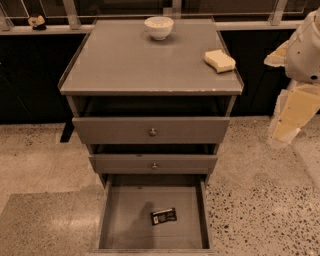

In [40]:
# episode = next(iter(language_table_episodic_dataset))
# steps = next(iter(episode['steps']))

# episode = episodes[0]

# Iterate over steps of the episode. Collect images.
# 反复看这一集的各个步骤。收集图像。
images = [trajectory['observation']['image'][id] for id in range(trajectory['observation']['image'].shape[0])]
images = [Image.fromarray(image.numpy()) for image in images]

display.Image(as_gif(images))

#Combination of multiple datasets

In [44]:
import tensorflow_datasets as tfds

robo_net_builder = tfds.builder_from_directory(builder_dir='gs://gresearch/robotics/robo_net/1.0.0/')
robo_net_builder_episodic_dataset = robo_net_builder.as_dataset(split='train[:10]')

episodes = list(iter(robo_net_builder_episodic_dataset))

episode = next(iter(robo_net_builder_episodic_dataset))
steps = next(iter(episode['steps']))
print(steps['action'])
keys = [key for key in steps['observation'].keys()]
print('The keys of observation:\n', keys)
print()

tf.Tensor([-0.07        0.07        0.05162682 -0.15315501  1.        ], shape=(5,), dtype=float32)
The keys of observation:
 ['image', 'image1', 'image2', 'state']



In [45]:
# The following will create a trajectories of length 3.
trajectory_length = 3

robo_net_rlds_spec = RLDSSpec(
    observation_info=robo_net_builder.info.features['steps']['observation'],
    action_info=robo_net_builder.info.features['steps']['action'],
)


def robo_net_step_map_fn(step):
  transformed_step = {}
  transformed_step['observation'] = step['observation']['image']
  transformed_step['is_first'] = step['is_first']
  transformed_step['is_last'] = step['is_last']
  transformed_step['is_terminal'] = step['is_terminal']
  return transformed_step

robo_net_trajectory_transform = TrajectoryTransformBuilder(robo_net_rlds_spec,step_map_fn=robo_net_step_map_fn,pattern_fn=n_step_pattern_builder(trajectory_length)).build(validate_expected_tensor_spec=False)


def mt_opt_step_map_fn(step):
  transformed_step = {}
  transformed_step['observation'] = tf.cast(tf.image.resize(step['observation']['image'], [240, 320]), tf.uint8)  # Resize to be compatible with robo_net trajectory
  transformed_step['is_first'] = step['is_first']
  transformed_step['is_last'] = step['is_last']
  transformed_step['is_terminal'] = step['is_terminal']
  return transformed_step

mt_opt_trajectory_transform = TrajectoryTransformBuilder(mt_opt_rlds_spec,step_map_fn=mt_opt_step_map_fn,pattern_fn=n_step_pattern_builder(trajectory_length)).build(validate_expected_tensor_spec=False)

In [46]:
# Validate that the specs are equal
assert robo_net_trajectory_transform.expected_tensor_spec == mt_opt_trajectory_transform.expected_tensor_spec

In [47]:
# Create trajectory datasets for the two normalized representations:
robo_net_trajectory_dataset = robo_net_trajectory_transform.transform_episodic_rlds_dataset(robo_net_builder_episodic_dataset)
mt_opt_trajectory_dataset = mt_opt_trajectory_transform.transform_episodic_rlds_dataset(mt_opt_episodic_dataset)

In [48]:
combined_dataset = tf.data.Dataset.sample_from_datasets([robo_net_trajectory_dataset, mt_opt_trajectory_dataset])
combined_dataset = combined_dataset.batch(2)
combined_dataset_it = iter(combined_dataset)

In [49]:
example = next(combined_dataset_it)

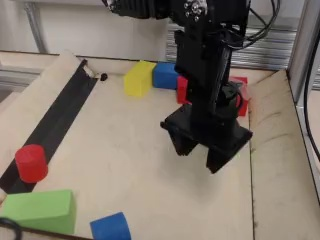

In [50]:
# First element of the batch returns a robot_net trajectory
Image.fromarray(example['observation'].numpy()[0][0])

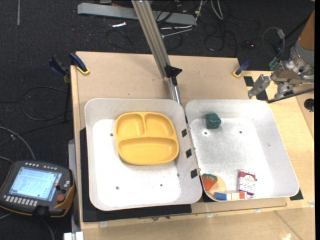

In [51]:
# Second element of the batch returns a mt_opt trajectory
Image.fromarray(example['observation'].numpy()[1][0])

#Available datasets and their sizes:

In [52]:
# Iterate over and make sure that a dataset can be created
# 反复检查并确保可以创建数据集
for name in DATASETS:
  uri = dataset2path(name)
  b = tfds.builder_from_directory(builder_dir=uri)
  split = list(b.info.splits.keys())[0]
  b.as_dataset(split=split)
  print('Dataset %s has size %s'%(uri, b.info.dataset_size))

Dataset gs://gresearch/robotics/fractal20220817_data/0.1.0 has size 111.07 GiB
Dataset gs://gresearch/robotics/kuka/0.1.0 has size 778.02 GiB
Dataset gs://gresearch/robotics/bridge/0.1.0 has size 387.49 GiB
Dataset gs://gresearch/robotics/taco_play/0.1.0 has size 47.77 GiB
Dataset gs://gresearch/robotics/jaco_play/0.1.0 has size 9.24 GiB
Dataset gs://gresearch/robotics/berkeley_cable_routing/0.1.0 has size 4.67 GiB
Dataset gs://gresearch/robotics/roboturk/0.1.0 has size 45.39 GiB
Dataset gs://gresearch/robotics/nyu_door_opening_surprising_effectiveness/0.1.0 has size 7.12 GiB
Dataset gs://gresearch/robotics/viola/0.1.0 has size 10.40 GiB
Dataset gs://gresearch/robotics/berkeley_autolab_ur5/0.1.0 has size 76.39 GiB
Dataset gs://gresearch/robotics/toto/0.1.0 has size 127.66 GiB
Dataset gs://gresearch/robotics/language_table/0.0.1 has size 399.23 GiB
Dataset gs://gresearch/robotics/columbia_cairlab_pusht_real/0.1.0 has size 2.80 GiB
Dataset gs://gresearch/robotics/stanford_kuka_multimodal